# SOLAR ORBITER - 2024 - March

This notebook documents the off-web workflow to use 3DCORE for analysis of a realtime Solar Orbiter Event March 2024

(23-03-2024) which gave in-situ signatures on [BepiColombo](https://helioforecast.space/icmecat/ICME_BEPI_MOESTL_20240324_01), [SolO](https://helioforecast.space/icmecat/ICME_SOLO_MOESTL_20240323_01) and [STEREO-A](https://helioforecast.space/icmecat/ICME_STEREO_A_MOESTL_20240324_01). It is reported in the DONKI database [here](https://kauai.ccmc.gsfc.nasa.gov/DONKI/view/CME/29715/5).

number 10 (22-09-2023) in the line-up database giving in-situ signatures on [PSP](https://helioforecast.space/icmecat/ICME_PSP_MOESTL_20230922_01), [Wind](https://helioforecast.space/icmecat/ICME_Wind_MOESTL_20230924_01) and [STEREO-A](https://helioforecast.space/icmecat/ICME_STEREO_A_MOESTL_20230924_01) and reported in the DONKI database [here](https://kauai.ccmc.gsfc.nasa.gov/DONKI/view/CME/27043/2).

## Data Preprocessing

We check the [CME Scoreboard](https://kauai.ccmc.gsfc.nasa.gov/CMEscoreboard/) for any suitable CME and prepare the realtime data.

In [1]:
%load_ext autoreload

%autoreload 2

# import packages
from coreweb.methods.offwebutils import extract_row, get_modelkwargs_ranges, offwebfit, get_eventinfo, update_posfig_offweb, generate_graphstore
from coreweb.dashcore.utils.plotting import check_animation, check_fittingpoints
from coreweb.dashcore.utils.utils import load_fit

import pandas as pd
from IPython.display import display, HTML

import datetime
import urllib

import matplotlib as matplotlib
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set_style('whitegrid')
sns.set_context('paper')

import os
import pickle as p

import warnings
warnings.filterwarnings('ignore')


# settings for plots

SMALL_SIZE = 20
MEDIUM_SIZE = 22
BIGGER_SIZE = 24

matplotlib.rcParams['mathtext.fontset'] = 'custom'
matplotlib.rcParams['mathtext.rm'] = 'DejaVu Sans'
matplotlib.rcParams['mathtext.it'] = 'DejaVu Sans:italic'
matplotlib.rcParams['mathtext.bf'] = 'DejaVu Sans:bold'
#matplotlib.rcParams['mathtext.fontset'] = 'stix' 
#matplotlib.rcParams['font.family'] = 'STIXGeneral'

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
# plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=SMALL_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('axes', titlesize=BIGGER_SIZE)  # fontsize of the figure title


/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/requests/__init__.py:86: RequestsDependencyWarning: Unable to find acceptable character detection dependency (chardet or charset_normalizer).
  warnings.warn(


In [2]:
start_date = datetime.datetime(2024,3,23).strftime('%Y-%m-%d')
end_date = datetime.datetime(2024,3,24).strftime('%Y-%m-%d')
base_path = os.path.join("src", "coreweb", "dashcore", "data")
path = os.path.abspath(base_path)

url_donki='https://kauai.ccmc.gsfc.nasa.gov/DONKI/WS/get/CMEAnalysis?startDate='+start_date+'&endDate='+end_date+'&mostAccurateOnly=true'
try: urllib.request.urlretrieve(url_donki,path+'DONKI.json')
except urllib.error.URLError as e:
    print('DONKI not loaded')

donkicat = pd.read_json(path+'DONKI.json')
print(f'# CMEs between {start_date} and {end_date}: ', len(donkicat))

filtered_donki = donkicat[donkicat['associatedCMEID'].str.contains('2024-03-23T01:25:00-CME-001')] # we extract the event with the correct ID
print('# CMEs filtered: ', len(filtered_donki))

# choose correct one!

catalogevent = filtered_donki.iloc[0]

for col in donkicat.columns:
    print(str(col) +': '+ str(catalogevent[col]))

dateFormat = "%Y-%m-%dT%H:%MZ"
cataloglaunchtime = datetime.datetime.strptime(catalogevent['time21_5'], dateFormat)

# CMEs between 2024-03-23 and 2024-03-24:  7
# CMEs filtered:  1
time21_5: 2024-03-23T03:19Z
latitude: 22
longitude: 2
halfAngle: 41
speed: 1613
type: O
isMostAccurate: True
associatedCMEID: 2024-03-23T01:25:00-CME-001
associatedCMEstartTime: 2024-03-23T01:25Z
note: Approximate measurement which follows the brighter bulk portion of this complex-shape event. Measured parameters are based on the source location and the best fit in SOHO LASCO C3 imagery, however the center of the elongated source eruption is not certain. There is a data gap in STEREO A COR2 imagery during this event so there was no stereoscopic viewpoint available to confirm the measured parameters. The half width of this CME is also not certain.
associatedCMELink: https://kauai.ccmc.gsfc.nasa.gov/DONKI/view/CME/29715/-1
catalog: M2M_CATALOG
featureCode: LE
dataLevel: 0
measurementTechnique: SWPC_CAT
imageType: running difference
tilt: nan
minorHalfWidth: nan
speedMeasuredAtHeight: 27.6
submissionTime: 2024-03-23T19:02Z
v

In [3]:
# import and process data

reference_frame = "RTN" 
idd = 'ICME_SOLO_MOESTL_20240323_01' # this is the ID of the event we want to analyze

eventinfo = get_eventinfo(idd, purelysyn=False)
graphstore, posstore, _ = generate_graphstore(eventinfo, reference_frame, {})


Data loaded from /Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/data/ICME_SOLO_MOESTL_20240323_01.pkl


## Plots

Once the data is loaded successfully, we can check the in situ data

In [4]:
graphstore['fig']

We run a model with some generic parameters and information from the Donki Catalog or set them manually.

### Set parameters for the model

In [5]:
# launchtime, set hours to impact
launch_formatted = cataloglaunchtime.strftime("%Y-%m-%d %H:%M")
launchlabel = f"Launch Time: {launch_formatted}"

print(launchlabel)

# model parameters

modelstatevars = [catalogevent['longitude'], # Longitude extracted from Donki Catalog, set manually otherwise
                  catalogevent['latitude'], # Latitude extracted from Donki Catalog, set manually otherwise
                  0., # Inclination
                  0.35, # Diameter 1 AU 
                  5., # Aspect Ratio
                  21.5, # Launch Radius
                  catalogevent['speed'], # Launch Velocity extracted from Donki Catalog, set manually otherwise
                  1.14, # Expansion Rate
                  1.00, # Background Drag
                  500., # Background Velocity
                  120., # T_Factor
                  1.64, # Magnetic Decay Rate
                  25., # Magnetic Field Strength 1 AU
                  ]


Launch Time: 2024-03-23 03:19


### Show a simple position overview

In [6]:
# plot positions


# choose from the following plot options: "Title", "Latitudinal Grid", "Longitudinal Grid","Trajectories","Synthetic Event","Catalog Event","AU axis","Trajectories","Parker Spiral","Catalog Event", "Timer"
plot_options = [
    "Title", 
    "Longitudinal Grid",
    "Trajectories",
    "Synthetic Event",
    "Catalog Event",
    "AU axis",
    "Trajectories",
    "Parker Spiral",
    "Catalog Event", 
    "Timer"]

# choose from the following spacecraft: "SOLO", "PSP", "BEPI", "Wind","STEREO-A", "SYN"
spacecraftoptions =["SOLO", "PSP", "BEPI", "STEREO-A"]

# choose from the following bodies: "Sun", "Mercury", "Venus","Earth"
bodyoptions = ["Sun", "Mercury", "Venus","Earth"]

togglerange = 0 # set to 0/1 to switch the longitude range
dim = "2D" # set to 2D/3D
currenttimeslider = 25 # set time since launch, irrelevant for 2D plot

# this function produces the figure
update_posfig_offweb(posstore, None, None, None,  togglerange, currenttimeslider, dim, graphstore, eventinfo, launchlabel, plot_options, spacecraftoptions, bodyoptions, reference_frame, *modelstatevars)[0]

### Show insitu data and 3D Plot

In [7]:
# choose from the following plot options: "Title", "Latitudinal Grid", "Longitudinal Grid","Trajectories","Synthetic Event","Catalog Event","AU axis","Trajectories","Parker Spiral","Catalog Event", "Timer"
plot_options = [
    "Title", 
    "Longitudinal Grid",
    "Trajectories",
    "Synthetic Event",
    "Catalog Event",
    "AU axis",
    "Trajectories",
    "Parker Spiral",
    "Catalog Event", 
    #"Timer"
    ]

# choose from the following spacecraft: "SOLO", "PSP", "BEPI", "Wind","STEREO-A", "SYN"
spacecraftoptions =["SOLO", "PSP", "BEPI", "STEREO-A"]

# choose from the following bodies: "Sun", "Mercury", "Venus","Earth"
bodyoptions = ["Sun", "Earth"]

#modelstatevars = [longit, latitu, inc, dia, asp, l_rad, l_vel, exp_rat, b_drag, bg_vel, t_fac, mag_dec, mag_strength]

view_legend_insitu = True
insitu = True
positions = True
plottheme = 'light-simple' # 'dark', 'light', 'dark-simple', 'light-simple'

camera = [1.0,-15,0] #'auto' give r, lon and lat

# this function creates the figure
checkanim = check_animation(None, None, plottheme, graphstore, reference_frame, None, None, None, currenttimeslider, eventinfo, launchlabel, plot_options, spacecraftoptions, bodyoptions,  insitu, positions, view_legend_insitu, camera.copy(), posstore, *modelstatevars)
#checkanim.write_html("checkanim.html")
checkanim

These do of course not provide perfect results. We will now fit the fluxrope with the data we have
## Fitting

We use an ABC Monte Carlo algorithm to fit the model to insitu data.

### Set the fitting points

These are used to determine the limits of an event and datapoints to calculate the RMSE during fitting.

In [8]:
t_launch = cataloglaunchtime.replace(tzinfo=None) # choose launch time

t_s = None
t_e = None

# choose arbitrary number of fitting points within the event

t_fit = None # will be set automatically

# t_fit =[
#     datetime.datetime(2024, 3, 23, 15, 30, tzinfo=datetime.timezone.utc),
#     datetime.datetime(2024, 3, 23, 16, tzinfo=datetime.timezone.utc),
#     datetime.datetime(2024, 3, 23, 16, 30, tzinfo=datetime.timezone.utc),
# ]

#we use 3 fitting points for now

showtitle = True

# this function creates a figure to visually check the previously set points
fig, t_s, t_e, t_fit = check_fittingpoints(graphstore, reference_frame, eventinfo, view_legend_insitu, showtitle, t_fit, t_s, t_e) 
fig

### Set the parameter ranges and fitting parameters

We can restrict some of the parameters already, but want to allow some uncertainty.

In [9]:
modelstatevar_ranges = [
    int(2**18) # ensemblesize
    ] + [
        [catalogevent['longitude'] - 40,catalogevent['longitude']+40], # Longitude (HEEQ)
        [catalogevent['latitude'] - 30,catalogevent['latitude'] +30], # Latitude (HEEQ)
        [0.,360.], # Inclination
        [0.05,0.35], # Diameter 1 AU 
        [1.,3.5], # Aspect Ratio  
        [21.5,21.5], # Launch Radius
        [catalogevent['speed'] - 100, catalogevent['speed'] + 100], # Launch Velocity
        [1.,2.0], # Expansion Rate
        [0.20,3.00], # Background Drag
        [100.,900.], # Background Velocity
        [-250.,250.], # T_Factor
        [1.,2.], # Magnetic Decay Rate
        [5.,65.], # Magnetic Field Strength 1 AU
    ]

modelkwargs = get_modelkwargs_ranges(modelstatevar_ranges)

multiprocessing = True

njobs = 4

itermin = 12
itermax = 15

n_particles = 512

In [10]:
# start the fitting process
filepath = offwebfit(t_launch, eventinfo, graphstore, multiprocessing, t_s, t_e, t_fit, njobs, itermin, itermax, n_particles, modelkwargs)

using noise model psd
Running iteration 0
Initial eps_init =  [1.31265806]
Starting simulations
Multiprocessing is used
547 reached particles                     
Setting new eps: [1.2864049] => [1.11592591]
Step 0 done, 5.24M runs in 26.51 seconds, (total: 00h 00m 26s)
Created directory /Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_SOLO_MOESTL_20240323_01_HEEQ_202505231711/00.pickle
Saved to /Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_SOLO_MOESTL_20240323_01_HEEQ_202505231711/00.pickle
Running iteration 1
Starting simulations
Multiprocessing is used


KeyboardInterrupt: 

In [10]:
# in case you don't want to rerun:

filepath = '/Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_SOLO_MOESTL_20240323_01_HEEQ_202505231711/00.pickle'

## Result Analysis

### Show the fitting results

The fitting results can be shown as a scatterplot or in a table.

In [11]:
folder_name = os.path.basename(os.path.dirname(filepath))
tablenew, *fitting_values, resdfdic, t0, mean_row, statfig = load_fit(folder_name, graphstore)

statfig

In [12]:
df_mean = pd.DataFrame.from_dict(mean_row)

pd.set_option("display.max_rows", None)

max_col_width = max(len(str(col)) for col in df_mean.columns[2:-1])

for col in df_mean.columns[1:-1]:
    print('{:<{}}{:>20} +/- {:>20}'.format(str(col) + ':', max_col_width + 1, str(df_mean[col][0]), str(df_mean[col][1])))

RMSE Ɛ:                                      1.17 +/-                  0.1
Longitude:                                   7.33 +/-                14.48
Latitude:                                    4.43 +/-                 9.07
Inclination:                               238.13 +/-                97.88
Diameter 1 AU:                               0.32 +/-                 0.02
Aspect Ratio:                                2.49 +/-                  0.7
Launch Radius:                               21.5 +/-                  0.0
Launch Velocity:                          1614.12 +/-                56.09
T_Factor:                                   17.82 +/-               153.45
Expansion Rate:                              1.16 +/-                 0.13
Magnetic Decay Rate:                         1.44 +/-                 0.29
Magnetic Field Strength 1 AU:               23.12 +/-                13.88
Background Drag:                             1.27 +/-                 0.77
Background Velocity:     

In [13]:
df = pd.DataFrame.from_dict(resdfdic)

pd.set_option("display.max_rows", None)

# Puts the scrollbar next to the DataFrame
display(HTML("<div style='height: 200px; overflow: auto; width: fit-content'>" +
             df.style.render() +
             "</div>"))

,Index,RMSE Ɛ,Longitude,Latitude,Inclination,Diameter 1 AU,Aspect Ratio,Launch Radius,Launch Velocity,T_Factor,Expansion Rate,Magnetic Decay Rate,Magnetic Field Strength 1 AU,Background Drag,Background Velocity,Number of Twists,Launch Time
0,0,1.010000,17.850000,18.060000,264.480000,0.340000,1.520000,21.500000,1524.800000,143.390000,1.050000,1.830000,26.240000,1.520000,817.360000,17.940000,2024-03-23 03:19
1,1,1.180000,-0.140000,-4.900000,212.790000,0.290000,1.570000,21.500000,1663.880000,-96.800000,1.060000,1.570000,17.940000,0.680000,429.680000,-11.850000,2024-03-23 03:19
2,2,1.190000,36.820000,4.680000,23.850000,0.330000,1.160000,21.500000,1571.020000,195.850000,1.060000,1.050000,35.710000,1.300000,789.560000,28.890000,2024-03-23 03:19
3,3,1.130000,-2.610000,-0.550000,347.210000,0.320000,1.040000,21.500000,1560.530000,226.900000,1.050000,1.270000,53.090000,1.990000,681.580000,35.470000,2024-03-23 03:19
4,4,0.970000,1.420000,8.060000,304.480000,0.330000,1.510000,21.500000,1679.560000,-91.660000,1.240000,1.550000,8.580000,0.320000,281.220000,-11.490000,2024-03-23 03:19
5,5,1.040000,-5.380000,30.260000,302.060000,0.280000,2.930000,21.500000,1576.510000,56.500000,1.040000,1.190000,6.060000,0.220000,561.460000,4.310000,2024-03-23 03:19
6,6,1.240000,-11.890000,5.060000,202.110000,0.310000,3.130000,21.500000,1633.860000,-103.440000,1.050000,1.060000,36.500000,0.930000,490.440000,-7.460000,2024-03-23 03:19
7,7,0.930000,-3.480000,16.290000,326.170000,0.340000,2.480000,21.500000,1703.760000,-2.010000,1.220000,1.730000,11.760000,0.820000,609.220000,-0.180000,2024-03-23 03:19
8,8,1.160000,-10.880000,-3.120000,346.330000,0.290000,3.050000,21.500000,1664.880000,196.700000,1.190000,1.050000,17.900000,2.640000,739.470000,14.500000,2024-03-23 03:19
9,9,1.210000,-5.700000,-4.520000,178.820000,0.320000,1.210000,21.500000,1673.690000,-109.260000,1.280000,1.590000,16.080000,2.030000,685.160000,-15.730000,2024-03-23 03:19


In [14]:
row= df.iloc[df['RMSE Ɛ'].idxmin()] # extract parameters from minimum eps row
row

Index                                        118
RMSE Ɛ                                       0.8
Longitude                                 -19.02
Latitude                                   22.65
Inclination                               329.85
Diameter 1 AU                               0.32
Aspect Ratio                                2.49
Launch Radius                               21.5
Launch Velocity                          1595.17
T_Factor                                   19.87
Expansion Rate                              1.05
Magnetic Decay Rate                         1.57
Magnetic Field Strength 1 AU               15.68
Background Drag                             0.38
Background Velocity                       730.75
Number of Twists                            1.73
Launch Time                     2024-03-23 03:19
Name: 118, dtype: object

In [15]:
# read from pickle file
file = open(filepath, "rb")
data = p.load(file)
file.close()
        
ensemble_filepath = filepath.split('.')[0] + '_ensembles.pickle'
with open(ensemble_filepath, 'rb') as ensemble_file:
    ensemble_data = p.load(ensemble_file)  

(4,)


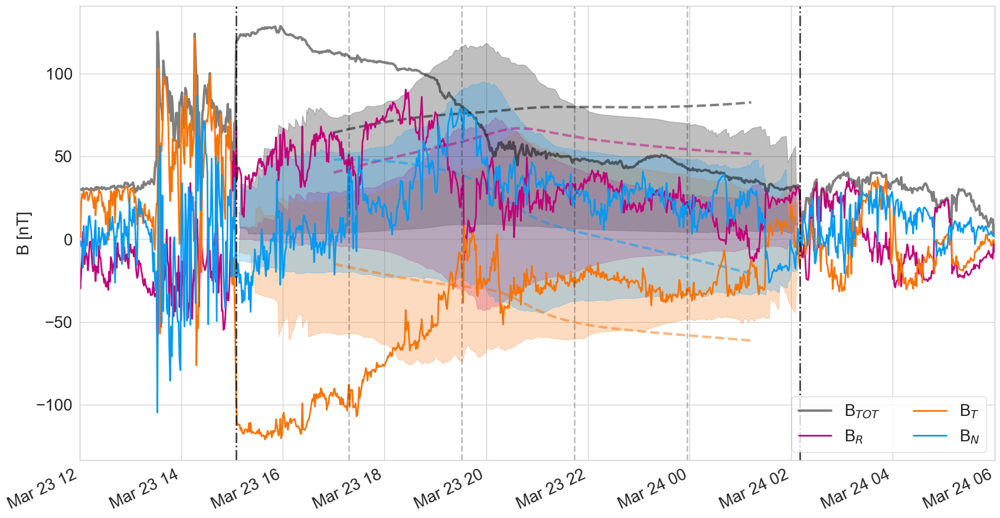

<Figure size 640x480 with 0 Axes>

In [16]:
from coreweb.fluxplot import fullinsitu

start_solo = datetime.datetime(2024, 3, 23, 12, tzinfo= None) #datetime.timezone.utc)
end_solo = datetime.datetime(2024, 3, 24, 6, tzinfo= None) #datetime.timezone.utc)

fullinsitu(observer='SOLO', launchtime=t_launch, t_fit=t_fit, start=start_solo, end=end_solo, t_s=t_s, t_e=t_e, 
              filepath=filepath, ref_frame='RTN', best=True, 
              ensemble=True, save_fig=True, legend=True, max_index=512, title=False, fit_points=True, graph=graphstore, row=row)

## STEREO-A fit

In [21]:
# import and process data

reference_frame = "RTN" 
id_sta = 'ICME_STEREO_A_MOESTL_20240324_01'

eventinfo_sta = get_eventinfo(id_sta)
graphstore_sta, posstore_sta, _ = generate_graphstore(eventinfo_sta, reference_frame, {})


Failed to load data from big archive: Data not contained in big Archive, trying recent data
position seems to be in AU already, skipping conversion
Data loaded from Data Archive
Loading body traces from Data Archive/Helioforecast
Body traces obtained successfully
['ICME_STEREO_A_MOESTL_20240324_01']
Mercury traces obtained from Archive/Helioforecast
Venus traces obtained from Archive/Helioforecast
Mars traces obtained from Archive/Helioforecast
Earth traces obtained from Archive/Helioforecast
Body data obtained successfully
Successfully loaded data for SOLO from Data Archive/Helioforecast
Successfully loaded data for PSP from Data Archive/Helioforecast
Successfully loaded data for BEPI from Data Archive/Helioforecast
Successfully loaded data for STEREO-A from Data Archive/Helioforecast


In [22]:
t_fit = None
# [
#     datetime.datetime(2024, 3, 24, 22, 00),
#     datetime.datetime(2024, 3, 25, 2, 30),
#     datetime.datetime(2024, 3, 25, 9, 30),
#     datetime.datetime(2024, 3, 25, 16, 30),
#     datetime.datetime(2024, 3, 25, 23, 30)
#     ]

# this function creates a figure to visually check the previously set points
fig, t_s, t_e, t_fit = check_fittingpoints(graphstore_sta, 'RTN', eventinfo_sta, view_legend_insitu, showtitle, t_fit, None, None) 
fig

In [23]:
filepath_sta = offwebfit(t_launch, eventinfo_sta, graphstore_sta, multiprocessing, t_s, t_e, t_fit, njobs, itermin, itermax, n_particles, modelkwargs)

using noise model psd
Running iteration 0
Initial eps_init =  [1.30128279]
Starting simulations
Multiprocessing is used
654 reached particles                     
Setting new eps: [1.27525713] => [1.13852143]
Step 0 done, 1.05M runs in 9.41 seconds, (total: 00h 00m 09s)
Created directory /Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_STEREO_A_MOESTL_20240324_01_HEEQ_202505231732/00.pickle
Saved to /Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_STEREO_A_MOESTL_20240324_01_HEEQ_202505231732/00.pickle
Running iteration 1
Starting simulations
Multiprocessing is used


KeyboardInterrupt: 

In [24]:
# in case you dont want to rerun
filepath_sta = '/Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_STEREO_A_MOESTL_20240324_01_HEEQ_202505231732/00.pickle'

folder_name_sta = os.path.basename(os.path.dirname(filepath_sta))
tablenew_sta, *fitting_values, resdfdic_sta, t0, mean_row_sta, statfig = load_fit(folder_name_sta, graphstore_sta)

df_sta = pd.DataFrame.from_dict(resdfdic_sta)

row_sta= df_sta.iloc[df_sta['RMSE Ɛ'].idxmin()] # extract parameters from random row
#row

# read from pickle file
file = open(filepath_sta, "rb")
data_sta = p.load(file)
file.close()
        
ensemble_filepath_sta = filepath_sta.split('.')[0] + '_ensembles.pickle'
with open(ensemble_filepath_sta, 'rb') as ensemble_file:
    ensemble_data_sta = p.load(ensemble_file)

df_mean_sta = pd.DataFrame.from_dict(mean_row_sta)  
pd.set_option("display.max_rows", None)

max_col_width_sta = max(len(str(col)) for col in df_mean_sta.columns[2:-1])

for col in df_mean_sta.columns[1:-1]:
    print('{:<{}}{:>20} +/- {:>20}'.format(str(col) + ':', max_col_width_sta + 1, str(df_mean_sta[col][0]), str(df_mean_sta[col][1])))

Generating and converting ensembles for all reference frames!


100%|██████████| 512/512 [05:59<00:00,  1.43it/s]


Shape of ensemble_HEEQ:  (9299, 512, 3)
Shape of ensemble_RTN:  (9299, 512, 3)
Shape of ensemble_GSM:  (9299, 512, 3)
RMSE Ɛ:                                      1.18 +/-                 0.08
Longitude:                                   9.25 +/-                16.41
Latitude:                                    6.81 +/-                 9.72
Inclination:                               204.43 +/-               114.74
Diameter 1 AU:                                0.3 +/-                 0.04
Aspect Ratio:                                2.33 +/-                  0.7
Launch Radius:                               21.5 +/-                  0.0
Launch Velocity:                          1608.81 +/-                56.11
T_Factor:                                   -3.37 +/-               164.25
Expansion Rate:                               1.5 +/-                 0.26
Magnetic Decay Rate:                          1.5 +/-                 0.29
Magnetic Field Strength 1 AU:               27.82 +/-    

(4,)


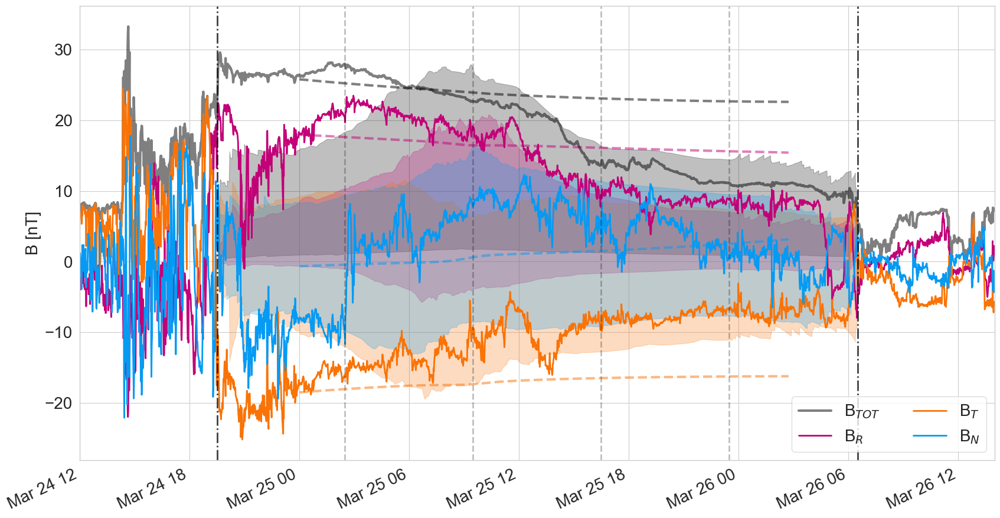

<Figure size 640x480 with 0 Axes>

In [25]:
start = datetime.datetime(2024, 3, 24, 12, tzinfo= None) #datetime.timezone.utc)
end = datetime.datetime(2024, 3, 26, 14, tzinfo= None) #datetime.timezone.utc)

fullinsitu(observer='STEREO-A', launchtime=t_launch, t_fit=t_fit, start=start, end=end, t_s=t_s, t_e=t_e, 
              filepath=filepath_sta, ref_frame='RTN', best=True, 
              ensemble=True, save_fig=True, legend=True, max_index=512, title=False, fit_points=True, graph=graphstore_sta, row=row_sta)

(4,)


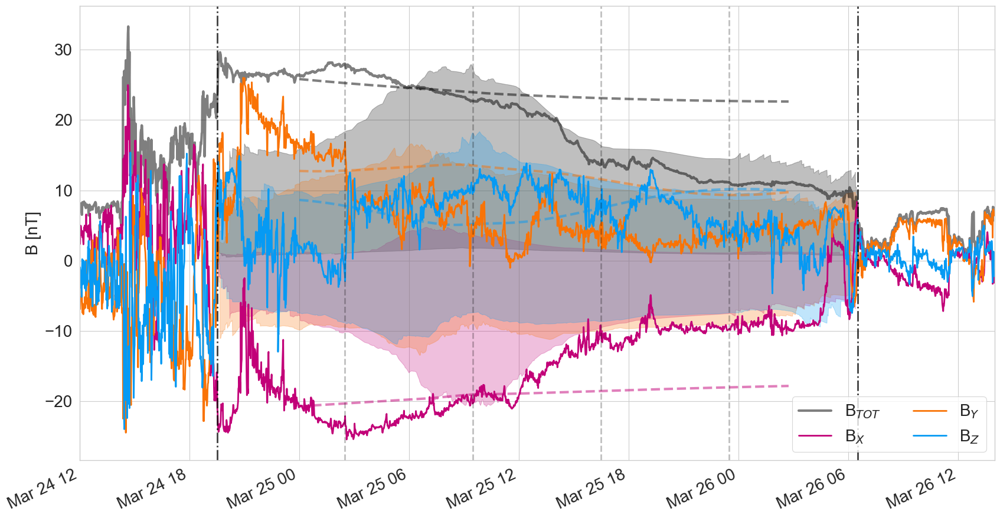

<Figure size 640x480 with 0 Axes>

In [26]:
ensemble_filepath_sta = filepath_sta.split('.')[0] + '_ensembles_GSM.pickle'

if os.path.exists(ensemble_filepath_sta):
    with open(ensemble_filepath_sta, 'rb') as ensemble_file:
        ensemble_data_sta = p.load(ensemble_file)  

fullinsitu(observer='STEREO-A', launchtime=t_launch, t_fit=t_fit, start=start, end=end, t_s=t_s, t_e=t_e, 
              filepath=filepath_sta, ref_frame='GSM', best=True, 
              ensemble=True, save_fig=True, legend=True, max_index=512, title=False, fit_points=True, graph=graphstore_sta, row=row_sta)

## BEPICOLOMBO

In [27]:
# import and process data

reference_frame = "RTN" 
id_bepi = 'ICME_BEPI_MOESTL_20240324_01'

eventinfo_bepi = get_eventinfo(id_bepi)
graphstore_bepi, posstore_bepi, _ = generate_graphstore(eventinfo_bepi, reference_frame, {})

loaded RTN data
Failed to load heeq data, converting RTN to HEEQ
Data loaded from Data Archive
Loading body traces from Data Archive/Helioforecast
Body traces obtained successfully
['ICME_BEPI_MOESTL_20240324_01']
Mercury traces obtained from Archive/Helioforecast
Venus traces obtained from Archive/Helioforecast
Mars traces obtained from Archive/Helioforecast
Earth traces obtained from Archive/Helioforecast
Body data obtained successfully
Successfully loaded data for SOLO from Data Archive/Helioforecast
Successfully loaded data for PSP from Data Archive/Helioforecast
Successfully loaded data for BEPI from Data Archive/Helioforecast
Successfully loaded data for STEREO-A from Data Archive/Helioforecast


In [26]:
t_fit = None
# [
#     #datetime.datetime(2024, 3, 24, 11, 30),
#     datetime.datetime(2024, 3, 24, 12, 15),
#     datetime.datetime(2024, 3, 24, 12, 45),
#     #datetime.datetime(2024, 3, 24, 13, 0),
#     datetime.datetime(2024, 3, 24, 13, 15)]

# this function creates a figure to visually check the previously set points
fig, t_s, t_e, t_fit = check_fittingpoints(graphstore_bepi, 'RTN', eventinfo_bepi, view_legend_insitu, showtitle, t_fit, None, None) 
fig

In [63]:
filepath_bepi = offwebfit(t_launch, eventinfo_bepi, graphstore_bepi, multiprocessing, t_s, t_e, t_fit, njobs, itermin, itermax, n_particles, modelkwargs)

python(92418) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(92419) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(92420) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(92421) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


using noise model psd
Running iteration 0
Initial eps_init =  [1.25616983]
Starting simulations
Multiprocessing is used


Process ForkPoolWorker-33:
Traceback (most recent call last):
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/process.py", line 314, in _bootstrap
    self.run()
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/pool.py", line 114, in worker
    task = get()
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/queues.py", line 368, in get
    res = self._reader.recv_bytes()
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/connection.py", line 219, in recv_bytes
    buf = self._recv_bytes(maxlength)
  File "/Users/hannahruedisser/miniforge3/envs/webenv/lib/python3.10/site-packages/multiprocess/connection.py", line 417, in _recv_bytes
   

KeyboardInterrupt: 

In [27]:
# in case you dont want to rerun
filepath_bepi = '/Users/hannahruedisser/3DCOREweb/src/coreweb/dashcore/output/ICME_BEPI_MOESTL_20240324_01_HEEQ_202504241327/05.pickle'

folder_name_bepi = os.path.basename(os.path.dirname(filepath_bepi))
tablenew_bepi, *fitting_values, resdfdic_bepi, t0, mean_row_bepi, statfig = load_fit(folder_name_bepi, graphstore_bepi)
df_bepi = pd.DataFrame.from_dict(resdfdic_bepi)

row_bepi= df_bepi.iloc[df_bepi['RMSE Ɛ'].idxmin()] # extract parameters from random row
#row

# read from pickle file
file = open(filepath_bepi, "rb")
data_bepi = p.load(file)
file.close()
        
ensemble_filepath_bepi = filepath_bepi.split('.')[0] + '_ensembles.pickle'
with open(ensemble_filepath_bepi, 'rb') as ensemble_file:
    ensemble_data_bepi = p.load(ensemble_file)

df_mean_bepi = pd.DataFrame.from_dict(mean_row_bepi)  
pd.set_option("display.max_rows", None)

max_col_width_bepi = max(len(str(col)) for col in df_mean_bepi.columns[2:-1])

for col in df_mean_bepi.columns[1:-1]:
    print('{:<{}}{:>20} +/- {:>20}'.format(str(col) + ':', max_col_width_bepi + 1, str(df_mean_bepi[col][0]), str(df_mean_bepi[col][1])))

RMSE Ɛ:                                      0.59 +/-                 0.03
Longitude:                                  30.89 +/-                 6.33
Latitude:                                   18.32 +/-                 6.19
Inclination:                               138.35 +/-                 8.58
Diameter 1 AU:                               0.08 +/-                 0.02
Aspect Ratio:                                2.75 +/-                 0.56
Launch Radius:                               21.5 +/-                  0.0
Launch Velocity:                          1607.18 +/-                54.68
T_Factor:                                  170.75 +/-                 46.1
Expansion Rate:                              1.51 +/-                 0.26
Magnetic Decay Rate:                         1.51 +/-                 0.28
Magnetic Field Strength 1 AU:               19.64 +/-                 4.06
Background Drag:                              1.9 +/-                 0.65
Background Velocity:     

(4,)


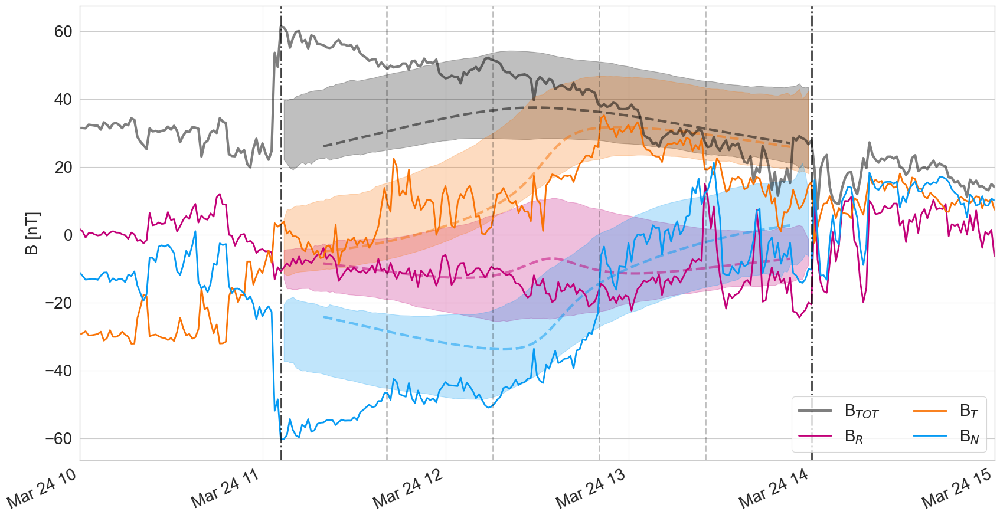

<Figure size 640x480 with 0 Axes>

In [28]:
start = datetime.datetime(2024, 3, 24, 10, tzinfo= None) #datetime.timezone.utc)
end = datetime.datetime(2024, 3, 24, 15, tzinfo= None) #datetime.timezone.utc)

fullinsitu(observer='BepiColombo', launchtime=t_launch, t_fit=t_fit, start=start, end=end, t_s=t_s, t_e=t_e, 
              filepath=filepath_bepi, ref_frame='RTN', best=True, 
              ensemble=True, save_fig=True, legend=True, max_index=512, title=False, fit_points=True, graph=graphstore_bepi, row=row_bepi)

Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9995065087145064
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9996429607159251
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  14.652033166834125
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9995065087145064
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9996429607159251
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  14.652033166834125
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9995065087145064
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  0.9996429607159251
Tracing Fieldlines
Residuals are not finite in the initial point.
total turns estimates:  14.652033166834125


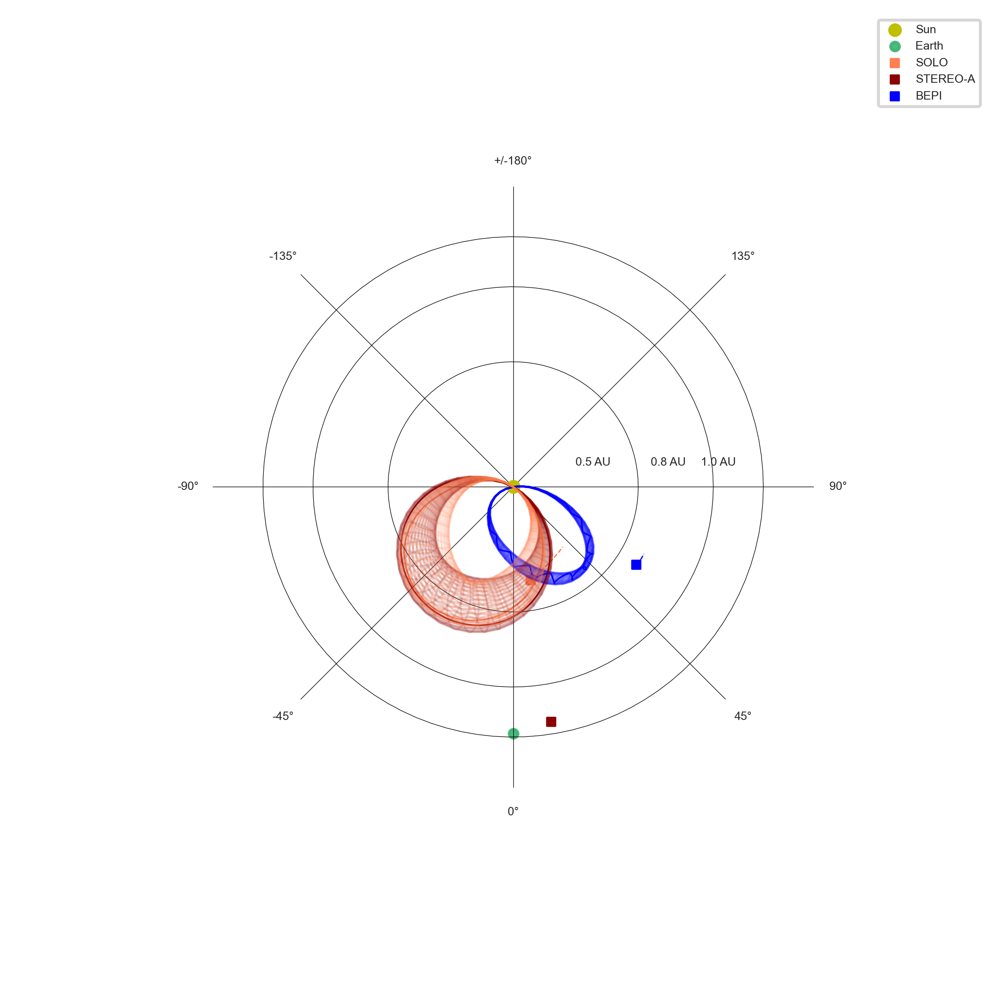

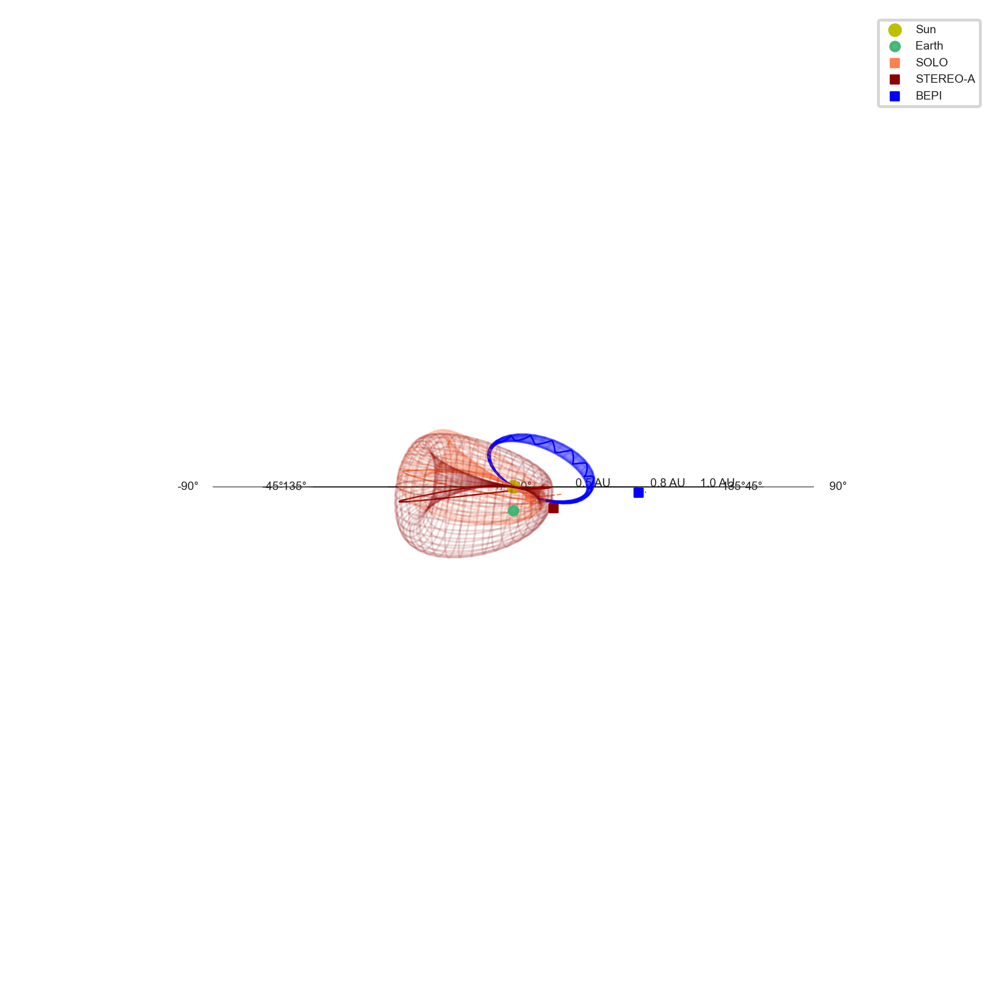

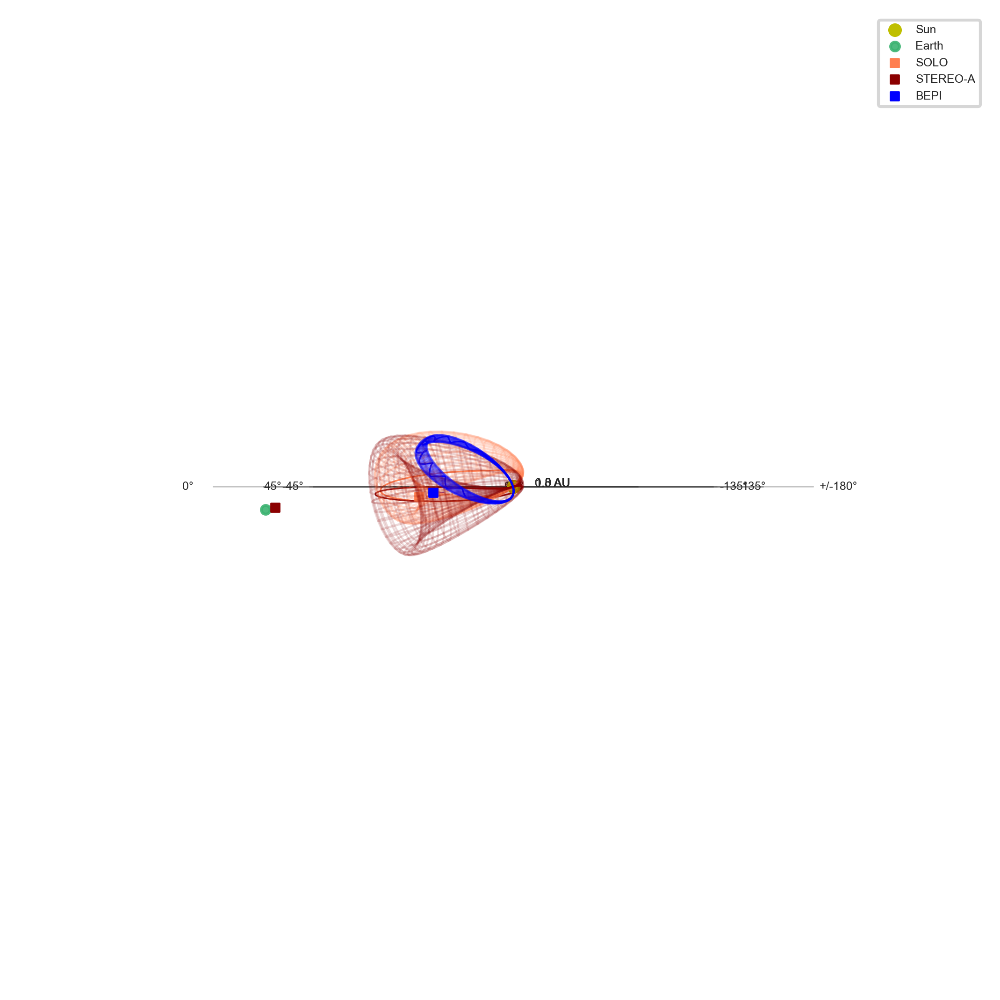

In [29]:
from coreweb.fluxplot import full3d, add_cme

plot_options = [
    #"Title", 
    "Longitudinal Grid",
    "Trajectories",
    "Synthetic Event",
    "Catalog Event",
    "AU axis",
    "Trajectories",
    "Parker Spiral",
    "Catalog Event", 
    #"Timer"
    ]

spacecraftoptions =["SOLO", "STEREO-A", "BEPI"]
bodyoptions = ["Sun", "Earth"]

tsnap = datetime.datetime(2024,3,23,20)   # t_s_solo #+ datetime.timedelta(hours=5)

fig, ax = full3d(graphstore, tsnap, plot_options, spacecraftoptions, bodyoptions, *extract_row(row), viewlegend = view_legend_insitu, posstore=posstore, addfield = True, launchtime=t_launch, title=False, view_azim=0, view_elev=90, view_radius=1.2, black=False, sc='SOLO', fontsize=6)
ax = add_cme(ax, graphstore_sta, tsnap, *extract_row(row_sta),addfield = True, launchtime=t_launch, sc='STEREO-A')
ax = add_cme(ax, graphstore_bepi, tsnap, *extract_row(row_bepi),addfield = True, launchtime=t_launch, sc='BEPI')

plt.savefig('march2024_3d_solo.pdf')

fig, ax = full3d(graphstore, tsnap, plot_options, spacecraftoptions, bodyoptions, *extract_row(row), viewlegend = view_legend_insitu, posstore=posstore, addfield = True, launchtime=t_launch, title=False, view_azim=0, view_elev=0, view_radius=1.2, black=False, sc='SOLO', fontsize=6)
ax = add_cme(ax, graphstore_sta, tsnap, *extract_row(row_sta),addfield = True, launchtime=t_launch, sc='STEREO-A')
ax = add_cme(ax, graphstore_bepi, tsnap, *extract_row(row_bepi),addfield = True, launchtime=t_launch, sc='BEPI')

plt.savefig('march2024_3d_solo_low.pdf')


fig, ax = full3d(graphstore, tsnap, plot_options, spacecraftoptions, bodyoptions, *extract_row(row), viewlegend = view_legend_insitu, posstore=posstore, addfield = True, launchtime=t_launch, title=False, view_azim=90, view_elev=0, view_radius=1.2, black=False, sc='SOLO', fontsize=6)
ax = add_cme(ax, graphstore_sta, tsnap, *extract_row(row_sta),addfield = True, launchtime=t_launch, sc='STEREO-A')
ax = add_cme(ax, graphstore_bepi, tsnap, *extract_row(row_bepi),addfield = True, launchtime=t_launch, sc='BEPI')

plt.savefig('march2024_3d_solo_high.pdf')